[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1ivA6dKTsMk-1SCLsQWbXEXsY1trwOkGH)

## Interactive Region Plotting

This notebook contains widgets for interactively plotting sonar data and corresponding regions. It uses `holoviews` library. The notebook is indented to run in Google Colab in order to access files from Google Drive and write the resulting outputs there as well. It can be adapted to work locally by adjusting the paths. 

In [ ]:
import matplotlib.pyplot as plt

In [ ]:
import os
import itertools

In [ ]:
import xarray as xr

In [ ]:
# install echoregions from a specific commit 
!pip install git+git://github.com/ngkavin/echoregions.git@14068acd330f4b230a8dfbbd481f0179c8f18e7f

  Cloning git://github.com/ngkavin/echoregions.git (to revision 14068acd330f4b230a8dfbbd481f0179c8f18e7f) to /tmp/pip-req-build-t9lo6m8k
  Running command git clone -q git://github.com/ngkavin/echoregions.git /tmp/pip-req-build-t9lo6m8k
  Running command git rev-parse -q --verify 'sha^14068acd330f4b230a8dfbbd481f0179c8f18e7f'
  Running command git fetch -q git://github.com/ngkavin/echoregions.git 14068acd330f4b230a8dfbbd481f0179c8f18e7f
  Running command git checkout -q 14068acd330f4b230a8dfbbd481f0179c8f18e7f
  Created wheel for echoregions: filename=echoregions-0.1-py3-none-any.whl size=24446 sha256=fa887d2895338c53acc894c2f904a00f8ba24a26ade187c995f238a4954ca855
  Stored in directory: /root/.cache/pip/wheels/1e/65/c9/75ac5b6c33ab195e029e3468b8f07297461be668e43784a442
Successfully built echoregions


In [ ]:
import echoregions as er

In [ ]:
!pip install git+git://github.com/OSOceanAcoustics/echopype.git@6af147cc0a2e2665c52091f0e8f3ac7c7e6e6601

  Cloning git://github.com/OSOceanAcoustics/echopype.git (to revision 6af147cc0a2e2665c52091f0e8f3ac7c7e6e6601) to /tmp/pip-req-build-rvg2ugcb
  Running command git clone -q git://github.com/OSOceanAcoustics/echopype.git /tmp/pip-req-build-rvg2ugcb
  Running command git rev-parse -q --verify 'sha^6af147cc0a2e2665c52091f0e8f3ac7c7e6e6601'
  Running command git fetch -q git://github.com/OSOceanAcoustics/echopype.git 6af147cc0a2e2665c52091f0e8f3ac7c7e6e6601
  Running command git checkout -q 6af147cc0a2e2665c52091f0e8f3ac7c7e6e6601
     |████████████████████████████████| 146 kB 5.6 MB/s 
     |████████████████████████████████| 125 kB 24.6 MB/s 
     |████████████████████████████████| 1.3 MB 25.1 MB/s 
     |████████████████████████████████| 271 kB 59.1 MB/s 
     |████████████████████████████████| 160 kB 58.4 MB/s 
     |████████████████████████████████| 52 kB 1.3 MB/s 
     |████████████████████████████████| 7.7 MB 25.6 MB/s 
     |████████████████████████████████| 127 kB 48.4 MB/s 
     

In [ ]:
# loading folder with region files

from google.colab import drive
drive.mount('/content/drive/') 

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
ls /content/drive/Shareddrives/pacific_hake_survey/EchoviewExports/Regions

csv_path/  x133.evr  x144.evr  x28.evr  x42.evr  x53.evr  x64.evr  x76.evr
x100.evr   x134.evr  x15.evr   x29.evr  x43.evr  x54.evr  x65.evr  x77.evr
x10.evr    x135.evr  x16.evr   x31.evr  x44.evr  x55.evr  x66.evr  x79.evr
x11.evr    x136.evr  x17.evr   x32.evr  x45.evr  x56.evr  x67.evr  x7.evr
x125.evr   x137.evr  x19.evr   x33.evr  x46.evr  x57.evr  x68.evr  x80.evr
x126.evr   x138.evr  x1.evr    x35.evr  x47.evr  x58.evr  x69.evr  x82.evr
x127.evr   x139.evr  x20.evr   x36.evr  x48.evr  x59.evr  x70.evr  x84.evr
x128.evr   x13.evr   x21.evr   x37.evr  x49.evr  x5.evr   x71.evr  x86.evr
x129.evr   x140.evr  x23.evr   x39.evr  x4.evr   x60.evr  x72.evr  x91.evr
x130.evr   x141.evr  x24.evr   x3.evr   x50.evr  x61.evr  x73.evr  x93.evr
x131.evr   x142.evr  x25.evr   x40.evr  x51.evr  x62.evr  x74.evr  x9.evr
x132.evr   x143.evr  x27.evr   x41.evr  x52.evr  x63.evr  x75.evr


In [ ]:
# path to evr files
EVR_PATH = '/content/drive/Shareddrives/pacific_hake_survey/EchoviewExports/Regions'


In [ ]:
# reading region filenames
import glob
evr_filelist = sorted(glob.glob(EVR_PATH+'/*.evr'))
print('There are '+ str(len(evr_filelist)) + ' files(transects).')

There are 94 files(transects).


In [ ]:
# paths to converted sonar files
RAW_PATH = '/content/drive/Shareddrives/uw-echospace/shared_data/SH1707/raw/'
SV_PATH = '/content/drive/Shareddrives/uw-echospace/shared_data/SH1707/Sv/'

In [ ]:
# reading region filenames
import glob
sv_filelist = sorted(glob.glob(SV_PATH+'/*.nc'))
raw_filelist = sorted(glob.glob(RAW_PATH+'/*.nc'))
print('There are '+ str(len(sv_filelist)) + ' sv files.')

There are 4339 sv files.


In [ ]:
# path to store pngs
OUTPUT_PATH = '/content/drive/Shareddrives/uw-echospace/shared_data/SH1707/region_png/'

In [ ]:
# sonar data reading function
def read_sv(sv_files, raw_files):
  """ 
    a function which reads files from a list and creates depth dimension for plotting
      * it needs both the raw files and the sv_files to adjust for the water_level
      * it assumes that the water_level is same for all files
  """


  # reading the processed platform data
  ds_plat = xr.open_mfdataset(raw_files, concat_dim='ping_time', group='Platform')
  # assuming water level is constant
  water_level = ds_plat.isel(location_time=0, frequency=0, ping_time=0).water_level
  del ds_plat
  ds_Sv = xr.open_mfdataset(sv_files, concat_dim='ping_time')
  range = ds_Sv.range.isel(frequency=0, ping_time=0)
  # assuming water levels are same for different frequncies and location_time
  depth = water_level + range
  depth = depth.drop_vars('frequency')
  depth = depth.drop_vars('location_time')
  # creating a new depth dimension
  ds_Sv['depth'] = depth
  ds_Sv = ds_Sv.swap_dims({'range_bin': 'depth'})
  # dropping first two depth levels as they are repeated
  Sv = ds_Sv.Sv[:,:,2:]
  del ds_Sv
  return(Sv)

### Plotting with Holoviews

In [ ]:
# need to install [all] to make holoviews.operation.datashader work  
!pip install holoviews[all]

In [ ]:
import holoviews as hv
import datashader as ds
from holoviews.operation import decimate
from holoviews.operation.datashader import datashade, rasterize
from holoviews import opts

In [ ]:
pip install hvplot

In [ ]:
import hvplot.xarray

In [ ]:
hv.__version__

'1.14.6'

### Plotting regions from a single file

In [ ]:
# read regions from evr file (we select the second file because it contains Hake regions)
r2d = er.read_evr(evr_filelist[1])

# select only Hake regions
Hake_region_ids = list(r2d.data[r2d.data.region_classification=='Hake'].region_id)


In [ ]:
# read corresponding sonar files and adjust depth
sv_files = r2d.select_sonar_file(sv_filelist, Hake_region_ids)
raw_files = r2d.select_sonar_file(raw_filelist, Hake_region_ids)

In [ ]:
Sv = read_sv(sv_files, raw_files)

/usr/local/lib/python3.7/dist-packages/xarray/backends/api.py:895: DeprecationWarning: When combine='by_coords', passing a value for `concat_dim` has no effect. This combination will raise an error in future. To manually combine along a specific dimension you should instead specify combine='nested' along with a value for `concat_dim`.
  DeprecationWarning,
/usr/local/lib/python3.7/dist-packages/xarray/backends/api.py:895: DeprecationWarning: When combine='by_coords', passing a value for `concat_dim` has no effect. This combination will raise an error in future. To manually combine along a specific dimension you should instead specify combine='nested' along with a value for `concat_dim`.
  DeprecationWarning,


In [ ]:
# reading region coordinates (note that there may be more than one region now but we are not slitting them, so we need to plot them as points)
r2d_df = r2d.data[r2d.data.region_classification=='Hake']
times = r2d_df.ping_time.replace('T',' ')
times_flat = list(itertools.chain(*list(times)))
depths = list(r2d_df.depth)
depths_flat = list(itertools.chain(*list(depths)))


In [ ]:
import echopype

In [ ]:
import matplotlib.cm

In [ ]:
cm_ek500 = matplotlib.cm.get_cmap('ep.ek500')

In [ ]:
clipping = {'min': 'white', 'max': 'brown', 'NaN': 'white'}

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
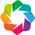

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


:DynamicMap   [frequency]
   :Image   [ping_time,depth]   (Sv)

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


In [ ]:
# plot using hv.Image
hv.extension('bokeh')
Sv_hv = hv.Dataset(Sv).to(hv.Image, kdims=["ping_time", "depth"])
rasterize(Sv_hv.opts(width=800, invert_yaxis=True, clim=(-74, -34), clipping_colors=clipping, cmap = cm_ek500))

In [ ]:
Sv.frequency

<xarray.DataArray 'frequency' (frequency: 3)>
array([ 18000.,  38000., 120000.])
Coordinates:
  * frequency  (frequency) float64 1.8e+04 3.8e+04 1.2e+05
Attributes:
    long_name:  Transducer frequency
    units:      Hz
    valid_min:  0.0

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
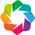

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


:DynamicMap   [frequency]
   :Overlay
      .Image.I  :Image   [ping_time,depth]   (Sv)
      .Points.I :Points   [x,y]

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


In [ ]:
# using hvplot instead
hv.extension('bokeh')
fig = Sv.hvplot.image(rasterize=True, x = 'ping_time', y = 'depth').opts(invert_yaxis=True, width=800, clim=(-76, -34), clipping_colors=clipping, cmap = cm_ek500)*hv.Points((times_flat, depths_flat)).opts(color='r')
fig

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
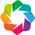

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


:DynamicMap   [frequency]
   :Overlay
      .Image.I :Image   [ping_time,depth]   (Sv)
      .Path.I  :Path   [x,y]

/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old


In [ ]:
# using hvplot instead
hv.extension('bokeh')
region_fig = hv.Path(zip(r2d_df.ping_time, r2d_df.depth)).opts(color='r')
Sv_fig = Sv.resample(ping_time="1s").mean().hvplot.image(rasterize=True, x = 'ping_time', y = 'depth').opts(invert_yaxis=True, width=800, clim=(-76, -34), clipping_colors=clipping, cmap = 'viridis')
Sv_fig*region_fig

In [ ]:
# create a list of indeces for the files which have Hake regions 
hake_idx = []
for it in range(len(evr_filelist)):
  r2d = er.read_evr(evr_filelist[it])
  # select only Hake regions
  Hake_region_ids = list(r2d.data[r2d.data.region_classification=='Hake'].region_id)
  if len(Hake_region_ids)>0:
    hake_idx.append(it)

len(hake_idx)

65

In [ ]:
# function plotting Sv files and corresponding regions within the it'th file in the hake_idx
import itertools
def plot_regions(it):
  # read regions from evr file
  r2d = er.read_evr(evr_filelist[it])
  # select only Hake regions
  Hake_region_ids = list(r2d.data[r2d.data.region_classification=='Hake'].region_id)
  # read corresponding sonar files and adjust depth
  sv_files = r2d.select_sonar_file(sv_filelist, Hake_region_ids)
  raw_files = r2d.select_sonar_file(raw_filelist, Hake_region_ids)
  Sv = read_sv(sv_files, raw_files)
  # coordinates for regions
  times = r2d.data[r2d.data.region_classification=='Hake'].ping_time.replace('T',' ')
  depths = list(r2d.data[r2d.data.region_classification=='Hake'].depth)
  # flattening
  times_flat = list(itertools.chain(*list(times)))
  depths_flat = list(itertools.chain(*list(depths)))
  # Sv_fig (downsampling to 1min)
  Sv_fig = hv.Dataset(Sv.isel(frequency=2).resample(ping_time="30s").mean()).to(hv.Image).opts(invert_yaxis=True, width=600, clim=(-74, -34), clipping_colors=clipping, cmap = cm_ek500)
  # region_fig
  # region_fig = hv.Points((times_flat, depths_flat)).opts(color='r')
  region_fig = hv.Path(zip(r2d_df.ping_time, r2d_df.depth)).opts(color='r')
  # joint fig
  fig = Sv_fig*region_fig

  return(fig)
  


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
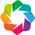

/usr/local/lib/python3.7/dist-packages/xarray/backends/api.py:895: DeprecationWarning: When combine='by_coords', passing a value for `concat_dim` has no effect. This combination will raise an error in future. To manually combine along a specific dimension you should instead specify combine='nested' along with a value for `concat_dim`.
  DeprecationWarning,
/usr/local/lib/python3.7/dist-packages/xarray/backends/api.py:895: DeprecationWarning: When combine='by_coords', passing a value for `concat_dim` has no effect. This combination will raise an error in future. To manually combine along a specific dimension you should instead specify combine='nested' along with a value for `concat_dim`.
  DeprecationWarning,
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: elementwise comparison failed; this will raise an error in the future.
  return new == old
/usr/local/lib/python3.7/dist-packages/bokeh/core/property/bases.py:249: DeprecationWarning: eleme

:Overlay
   .Image.I  :Image   [ping_time,depth]   (Sv)
   .Points.I :Points   [x,y]

In [ ]:
# test plot_regions function
import numpy as np
hv.extension('bokeh')
plot_regions(hake_idx[0])

In [ ]:
Sv.frequency

NameError: ignored

### Panel, Class, Param Approach

Here we will create a panel visualization which is managed by a small class holding the slider parameter and the plotting function. This approach avoids the current problem with HoloMap and Dynamic Map (below) which cannot handle the `rasterize = True` and `framewise = True` options at the same time (descirbed in this [issue](https://github.com/holoviz/holoviews/issues/4820)). Once the issue is resolved possibly the one line options will work.



In [ ]:
import param

In [ ]:
import panel as pn

In [ ]:
class RegionExplorer(param.Parameterized):
    
    it = param.Integer(default=1, bounds=(1, len(hake_idx)))
    _default_freq = 38000
    freqs = param.ObjectSelector(default=_default_freq, objects=[38000, 120000, 200000])

    @param.depends('it')
    def plot_regions(self):
      # read regions from evr file
      r2d = er.read_evr(evr_filelist[hake_idx[self.it-1]])
      # select only Hake regions
      Hake_region_ids = list(r2d.data[r2d.data.region_classification=='Hake'].region_id)
      # read corresponding sonar files and adjust depth
      sv_files = r2d.select_sonar_file(sv_filelist, Hake_region_ids)
      raw_files = r2d.select_sonar_file(raw_filelist, Hake_region_ids)
      Sv = read_sv(sv_files, raw_files)
      # coordinates for regions
      times = r2d.data[r2d.data.region_classification=='Hake'].ping_time.replace('T',' ')
      depths = list(r2d.data[r2d.data.region_classification=='Hake'].depth)
      # flattening
      times_flat = list(itertools.chain(*list(times)))
      depths_flat = list(itertools.chain(*list(depths)))
      # echogram_fig
      Sv_fig = Sv.sel(frequency=self.freqs).resample(ping_time="1s").mean().hvplot.image(rasterize=True, x = 'ping_time', y = 'depth').opts(invert_yaxis=True, width=800, clim=(-74, -34), clipping_colors=clipping, cmap = cm_ek500)
      # region_fig
      region_fig = hv.Points((times_flat, depths_flat)).opts(color='r')
      # joint fig
      fig = (Sv_fig*region_fig).opts(opts.Points(framewise=True))
      return(fig)

NameError: ignored

In [ ]:
hv.extension('bokeh')
explorer = RegionExplorer()
pn.Column(explorer.param, explorer.plot_regions)